In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
import matplotlib 
import plotly.express as px
matplotlib.rcParams["figure.figsize"] = (20,10)

In [4]:
import seaborn as sns


In [2]:
df = pd.read_csv('collegereview2023.csv',lineterminator='\n')
df = df.drop(columns=['Unnamed: 0'])
df

,Name,college,review,rating
0,Aariz Amaan,IILM University,The faculty-student ratio is good none of the ...,7.0
1,Saurabh,Lovely Professional University - [LPU],There are many fests. In which the name of the...,10.0
2,Prasanna,Adithya Institute of Technology - [AIT],I am B tech (IT) The desire is not only intere...,6.3
3,Darshan,Chandigarh University - [CU],The campus life is very good. They conduct an ...,10.0
4,Sakshi Kishor Apsunde,Pune Vidyarthi Griha's College of Engineering ...,From the 3rd year and 1st semester of the 4th ...,9.0
...,...,...,...,...
3335,Farhaz khan,Rajiv Gandhi University of Knowledge Technolog...,The curriculum here in this RAJIV GANDHI UNIVE...,9.2
3336,Narla Preetham,Jawaharlal Nehru Technological University - [J...,It is a wonderful college and spacious with ma...,10.0
3337,Anil marada,Anil Neerukonda Institute of Technology & Scie...,Because anits good college and it has more and...,10.0
3338,Rahul Kumar,Amity School of Engineering & Technology - [ASET],Placement in the college is pretty much fine. ...,6.2


In [6]:
df.college.value_counts()

college
Bharath University - Bharath Institute of Higher Education and Research - [BIHER]    121
National Institute of Technology - [NIT]                                             106
Lovely Professional University - [LPU]                                                67
Techno India University                                                               52
Medi-Caps University                                                                  41
                                                                                    ... 
Aravali College of Engineering and Management - [ACEM]                                 1
P.S.G College of Technology - [PSGCT]                                                  1
Andhra University, College of Engineering - [AUCE]                                     1
St Peter's College of Engineering and Technology - [SPCET]                             1
Amity School of Engineering & Technology - [ASET]                                      1
Name: count, 

In [7]:
df.shape

(3340, 4)

In [3]:
df2 = pd.read_csv('collegereview2022.csv',lineterminator='\n')
df2 = df2.drop(columns=['Unnamed: 0'])
df2

,Name,college,review,rating
0,Kerthi M,Sri Manakula Vinayagar Engineering College,The placements offered by the college are good...,8.5
1,Manjeet pal,Dayalbagh Educational Institute Faculty of Eng...,Placement in the college is very good there ar...,10.0
2,Sanjay nimmala,Sree Dattha Group of Institutions - Integrated...,The fee structure in this college is very affo...,10.0
3,Manasa,Sree Dattha Institute of Engineering and Scien...,The fee structure in this college is for a civ...,10.0
4,Manas Maheshwari,VIT Bhopal University,College life at VIT Bhopal isn't as good as yo...,8.0
...,...,...,...,...
9692,Vipul singh,SRM Institute of Science and Technology - [SRM...,SRM entrance exams.\r\nI had the choice of Man...,8.5
9693,Anil,GNA University,Placement facility of this university is very ...,6.8
9694,SUMAN HEMBRAM,Indian Institute of Engineering Science and Te...,The campus is clean and well observed. The deb...,8.3
9695,AKASH KUMAR,National Institute of Technology - [NITC],The course structure is awesome.Here the entir...,8.5


In [4]:
df2.college.nunique()

1661

In [10]:
df2.shape

(9697, 4)

In [5]:
df3 = pd.read_csv('collegereview2021.csv',lineterminator='\n')
df3 = df3.drop(columns=['Unnamed: 0'])
df3

,Name,college,review,rating
0,Nimalraj,SNS College of Technology - [SNSCT],"The annual fee for the course is 1,25,000. Now...",6.0
1,Priyaranjan kumar,Bhagalpur College of Engineering - [BCE],The hostel life and social life in this colleg...,9.7
2,Aftab Shaikh,Shree LR Tiwari College of Engineering - [SLRTCE],I chose this course because I was interested i...,8.0
3,Shreya sneh,IILM University,There is IGNITE fest in the university held on...,10.0
4,Yuv Raj Singh,Galgotias University - [GU],The civil department is very good in this coll...,6.2
...,...,...,...,...
18293,Kuldeep kori,"University Institute of Technology, Rajiv Gand...",Rgpv Bhopal has one of the best campus life. T...,7.8
18294,DEBSRUTI DASGUPTA,Xavier Institute of Management - [XIMB],"Life at the campus is very lively, The annual ...",9.1
18295,MOHIT KUMAR SINGH,KIET Group of Institutions - [KIET],•As with the growing technology it's a must to...,7.2
18296,Sanjana,HI-Tech Institute of Engineering and Technolog...,I choose this course because I am interested i...,7.8


In [12]:
df3.college.value_counts()

college
Chandigarh University - [CU]                                  323
National Institute of Technology - [NIT]                      317
Netaji Subhas University of Technology - [NSUT]               288
Delhi Technological University - [DTU]                        262
Noida Institute of Engineering and Technology - [NIET]        195
                                                             ... 
Vels Institute of Science, Technology & Advanced Studies        1
Bangalore University - [BU]                                     1
Sai Ganapathi Engineering College                               1
Sri Ramachandra Institute of Higher Education and Research      1
GNIOT Institute of Management Studies - [GIMS]                  1
Name: count, Length: 2269, dtype: int64

In [13]:
df3.college.nunique()

2269

In [14]:
import nltk
from nltk import FreqDist
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/int1463/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [15]:
import re
import spacy
import pyLDAvis
import gensim
from gensim import corpora

In [16]:
df3.shape

(18298, 4)

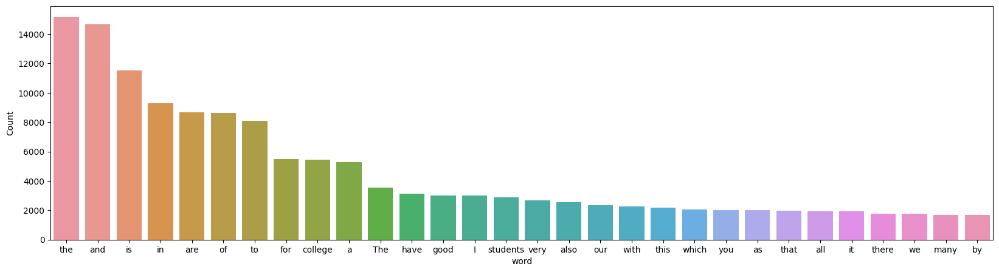

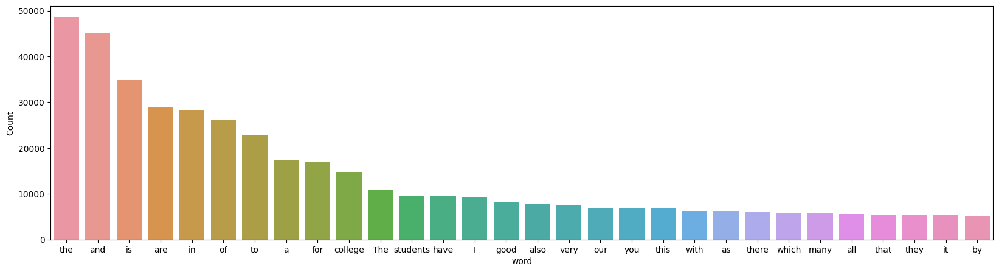

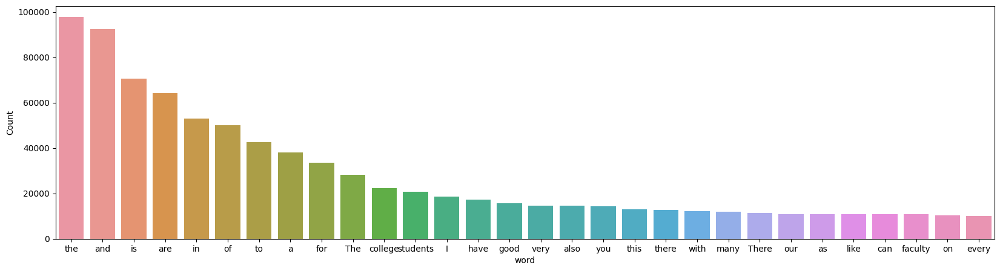

In [17]:
# function to plot most frequent terms
def freq_words(x, terms = 30):
  all_words = ' '.join([text for text in x])
  all_words = all_words.split()

  fdist = FreqDist(all_words)
  words_df = pd.DataFrame({'word':list(fdist.keys()), 'count':list(fdist.values())})

  # selecting top 20 most frequent words
  d = words_df.nlargest(columns="count", n = terms) 
  plt.figure(figsize=(20,5))
  ax = sns.barplot(data=d, x= "word", y = "count")
  ax.set(ylabel = 'Count')
  plt.show()

freq_words(df['review'])
freq_words(df2['review'])
freq_words(df3['review'])

In [18]:
# remove unwanted characters, numbers and symbols
df['review'] = df['review'].str.replace("[^a-zA-Z#]", " ")
df2['review'] = df2['review'].str.replace("[^a-zA-Z#]", " ")
df3['review'] = df3['review'].str.replace("[^a-zA-Z#]", " ")

In [19]:
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
# function to remove stopwords
def remove_stopwords(rev):
    rev_new = " ".join([i for i in rev if i not in stop_words])
    return rev_new

In [20]:
# remove short words (length < 3)
df['review'] = df['review'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>2]))
df2['review'] = df2['review'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>2]))
df3['review'] = df3['review'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>2]))

df3.shape

(18298, 4)

In [21]:
# remove stopwords from the text
reviews1 = [remove_stopwords(r.split()) for r in df['review']]
# print(len(reviews1))
reviews2 = [remove_stopwords(r.split()) for r in df2['review']]
# print(len(reviews2))
reviews3 = [remove_stopwords(r.split()) for r in df3['review']]
# print(len(reviews3))
type(reviews3)


list

In [22]:
reviews = reviews1 + reviews2 + reviews3
len(reviews)

31335

In [23]:
# make entire text lowercase
reviews = [r.lower() for r in reviews]

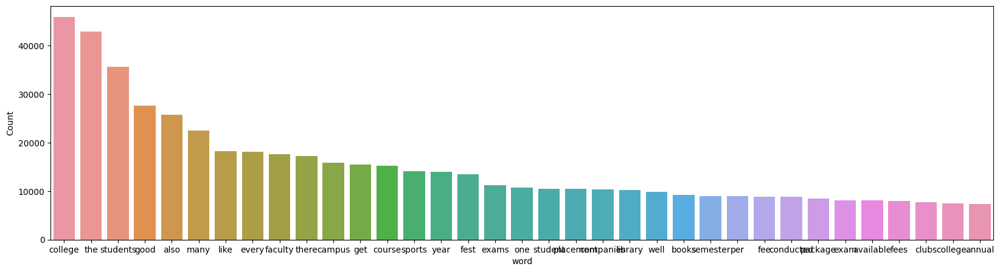

In [24]:
freq_words(reviews, 35)

In [25]:
load_model = spacy.load('en_core_web_sm', disable = ['parser','ner'])

In [26]:
def lemmatization(texts, tags=['NOUN', 'ADJ']): # filter noun and adjective
       output = []
       for sent in texts:
             doc = load_model(" ".join(sent)) 
             output.append([token.lemma_ for token in doc if token.pos_ in tags])
       return output

In [27]:
tokenized_reviews = pd.Series(reviews).apply(lambda x: x.split())
print(tokenized_reviews[1])

['there', 'many', 'fests.', 'name', 'annual', 'fest', 'lpu', 'fest', 'conducted', 'month', 'december', 'january', 'there', 'availability', 'books', 'library', 'student', 'want.', 'there', 'amenities', 'every', 'classroom.', 'the', 'best', 'thing', 'college', 'every', 'sports', 'activities', 'faculty', 'college.', 'there', 'big', 'playground.', 'there', 'many', 'clubs', 'everyone', 'able', 'join', 'basis', 'interest.the', 'fees', 'students', 'give', 'semester-wise', 'yearly', 'fee', 'lakhs', 'four', 'years', 'btech', 'there', 'scholarships', 'class', 'based', 'study', 'hard', 'get', '100%', 'scholarships', 'also,', '98%', 'placement', 'year', 'college.']


In [28]:
reviews_2 = lemmatization(tokenized_reviews)
print(reviews_2[1]) # print lemmatized review

['many', 'fest', 'name', 'annual', 'f', 'lpu', 'f', 'month', 'availability', 'book', 'library', 'student', 'want', 'classroom', 'good', 'thing', 'college', 'sport', 'activity', 'faculty', 'college', 'big', 'playground', 'many', 'club', 'able', 'join', 'basis', 'fee', 'student', 'semester', 'wise', 'yearly', 'fee', 'lakh', 'year', 'btech', 'class', 'study', '%', 'scholarship', '%', 'placement', 'year', 'college']


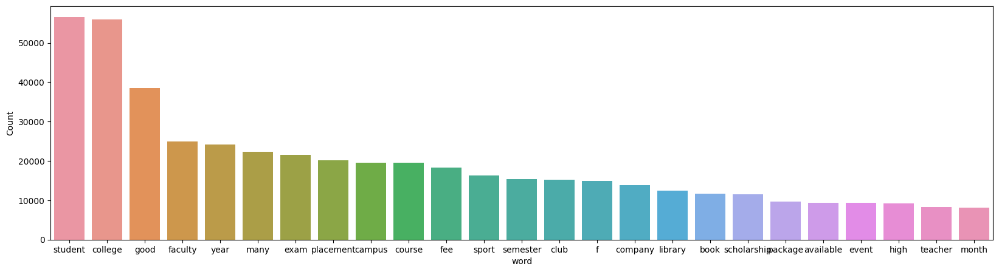

In [29]:
#detokenize

reviews_3 = []
for i in range(len(reviews_2)):
    reviews_3.append(' '.join(reviews_2[i]))

freq_words(reviews_3,25)

In [30]:
#LDA

dictionary = corpora.Dictionary(reviews_2)

doc_term_matrix = [dictionary.doc2bow(rev) for rev in reviews_2]
# Creating the object for LDA model using gensim library
LDA = gensim.models.ldamodel.LdaModel

# Build LDA model
lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=15, random_state=100,
                chunksize=1000, passes=50)

In [31]:
lda_model.print_topics()

[(0,
  '0.070*"student" + 0.030*"university" + 0.025*"various" + 0.021*"field" + 0.019*"industry" + 0.015*"research" + 0.013*"experience" + 0.013*"curriculum" + 0.013*"course" + 0.012*"academic"'),
 (1,
  '0.142*"campus" + 0.073*"life" + 0.033*"society" + 0.029*"good" + 0.026*"infrastructure" + 0.022*"lot" + 0.020*"girl" + 0.019*"big" + 0.016*"club" + 0.015*"great"'),
 (2,
  '0.103*"placement" + 0.084*"student" + 0.066*"company" + 0.058*"package" + 0.041*"campus" + 0.041*"college" + 0.039*"high" + 0.033*"year" + 0.032*"average" + 0.028*"good"'),
 (3,
  '0.336*"sem" + 0.060*"point" + 0.030*"pursue" + 0.029*"criterion" + 0.027*"eligibility" + 0.025*"methodology" + 0.022*"view" + 0.017*"health" + 0.017*"fantastic" + 0.017*"evaluation"'),
 (4,
  '0.089*"nit" + 0.058*"alumnus" + 0.041*"collage" + 0.039*"iit" + 0.028*"counseling" + 0.028*"candidate" + 0.021*"conducted" + 0.021*"expense" + 0.018*"speaker" + 0.017*"network"'),
 (5,
  '0.288*"year" + 0.134*"first" + 0.051*"1st" + 0.051*"second"

#TOPICS  
1. Campus life & facilities
2. Examination details and structure
4. fee & scholarship details
6. Internship & Placement oppurtunities
7. Events
8. Club ans sports activities
9. Criteria for admission


In [6]:
df4 = df.copy()
df5 = df2.copy()
df6 = df3.copy()

In [7]:
df_m = df4.merge(df5 , how = 'outer')


In [8]:
final_df = df_m.merge(df6, how = 'outer')
final_df

,Name,college,review,rating
0,Aariz Amaan,IILM University,The faculty-student ratio is good none of the ...,7.0
1,Saurabh,Lovely Professional University - [LPU],There are many fests. In which the name of the...,10.0
2,Prasanna,Adithya Institute of Technology - [AIT],I am B tech (IT) The desire is not only intere...,6.3
3,Darshan,Chandigarh University - [CU],The campus life is very good. They conduct an ...,10.0
4,Sakshi Kishor Apsunde,Pune Vidyarthi Griha's College of Engineering ...,From the 3rd year and 1st semester of the 4th ...,9.0
...,...,...,...,...
30423,Kunal,Symbiosis Institute of Business Management - [...,Life here at SIBM Bangalore is full of rigour....,6.9
30424,Ayush Maikhuri,Xavier Institute of Management - [XIMB],Because it is better than most of the baby and...,8.0
30425,DEBSRUTI DASGUPTA,Xavier Institute of Management - [XIMB],"Life at the campus is very lively, The annual ...",9.1
30426,Sanjana,HI-Tech Institute of Engineering and Technolog...,I choose this course because I am interested i...,7.8


In [10]:
final_df.college.value_counts()

college
National Institute of Technology - [NIT]               580
Chandigarh University - [CU]                           496
Delhi Technological University - [DTU]                 392
Lovely Professional University - [LPU]                 384
Netaji Subhas University of Technology - [NSUT]        365
                                                      ... 
Birla Institute of Applied Science                       1
VishwaVidyalaya Engineering College - [VEC]              1
K. Ramakrishnan College of Engineering -[KRCE]           1
Dr. D.Y. Patil Pratishthan's College of Engineering      1
GNIOT Institute of Management Studies - [GIMS]           1
Name: count, Length: 2876, dtype: int64

In [11]:
final_df['review_size'] = [len(r) for r in final_df.review]

In [12]:
final_df.head()

,Name,college,review,rating,review_size
0,Aariz Amaan,IILM University,The faculty-student ratio is good none of the ...,7.0,505
1,Saurabh,Lovely Professional University - [LPU],There are many fests. In which the name of the...,10.0,706
2,Prasanna,Adithya Institute of Technology - [AIT],I am B tech (IT) The desire is not only intere...,6.3,892
3,Darshan,Chandigarh University - [CU],The campus life is very good. They conduct an ...,10.0,626
4,Sakshi Kishor Apsunde,Pune Vidyarthi Griha's College of Engineering ...,From the 3rd year and 1st semester of the 4th ...,9.0,758


In [13]:
final_df.describe()

,rating,review_size
count,30428.000000,30428.000000
mean,8.000762,747.569311
std,1.314290,325.081879
min,1.000000,235.000000
25%,7.300000,531.000000
50%,8.100000,640.000000
75%,9.000000,846.000000
max,10.000000,7092.000000


In [37]:
stats = final_df.college.value_counts()
len(stats[stats > 10])

619

In [40]:
less_than_10 = stats[stats <= 10]
temp_df = final_df.copy()
temp_df.college = temp_df.college.apply(lambda x : None if x in less_than_10 else x)

In [45]:
temp_df.isna().sum()

Name          0
college    7023
review        0
rating        0
dtype: int64

In [46]:
temp_df = temp_df.dropna()

In [69]:
temp_df.college.nunique()

619

In [14]:
dict = {
    'College' : [],
    'reviews' : [],
    'rating' : []
}
dict2 = {
    'College' : [],
    'reviews' : [],
    'rating' : []
}
avg_ratings = []
print(len(final_df.groupby('college')))
for key , subdf in final_df.groupby('college'):
    reviews = (list(subdf['review']))
    # print(len(reviews))
    ratings = list(subdf['rating'])
    avg_ratings = subdf['rating'].mean()
    dict['College'].append(key)
    dict['reviews'].append(reviews)
    dict['rating'].append(avg_ratings)
    dict2['College'].append(key)
    dict2['reviews'].append(reviews)
    dict2['rating'].append(ratings)

print(dict)
data = pd.DataFrame(dict)
data2 = pd.DataFrame(dict2)

2876
{'College': ['A. C. Patil College of Engineering - [ACPCE]', 'A. D. Patel Institute of Technology - [ADIT]', 'A. P. Shah Institute of Technology - [APSIT]', 'A.A.N.M & V.V.R.S.R Polytechnic', 'A.V. College of Arts Science and Commerce - [AV College]', 'A.V.C College of Engineering - [AVCCE]', 'A1 Global Institute of Engineering & Technology', 'AAA College of Engineering & Technology', 'AAR Mahaveer Engineering College', 'ABES Engineering College', 'ABES Institute of Technology - [ABESIT]', "ABMSP's Anantrao Pawar College of Engineering & Research - [APCOER]", 'ABR College of Engineering and Technology', 'ACE College Of Engineering & Management', 'ACE College of Engineering', 'ACE Engineering College - [ACEEC]', 'ACS College of Engineering - [ACSCE]', 'ACSR Government Medical College', 'AG Patil Institute of Technology - [AGPIT]', 'AISSMS College of Engineering - [AISSMSCOE]', 'AISSMS Institute of Information Technology', 'AJ Institute of Engineering and Technology - [AJIET]', 'AJ 

In [10]:
data.head(10)

,College,reviews,rating
0,A. C. Patil College of Engineering - [ACPCE],[Job opportunities are given more importance i...,7.840000
1,A. D. Patel Institute of Technology - [ADIT],[Infrastructure is outstanding. Lab facilities...,6.850000
2,A. P. Shah Institute of Technology - [APSIT],[Faculties are very much co-operative and they...,7.850000
3,A.A.N.M & V.V.R.S.R Polytechnic,[To enter 3rd year are eligible for placements...,7.800000
4,A.V. College of Arts Science and Commerce - [A...,[The students who are studying final year are ...,9.200000
5,A.V.C College of Engineering - [AVCCE],[Our college has both men ane women in approxi...,6.800000
6,A1 Global Institute of Engineering & Technology,"[Global mahotsav, freshers, fairwell, August 1...",9.200000
7,AAA College of Engineering & Technology,[They provide good placements.and they are tye...,9.800000
8,AAR Mahaveer Engineering College,[According to my campus JNTU Hyderabad campus ...,9.300000
9,ABES Engineering College,[Teachers in our college were good and knowled...,8.266972


In [17]:
data2.head(10)

,College,reviews,rating
0,A. C. Patil College of Engineering - [ACPCE],[Job opportunities are given more importance i...,"[8.7, 8.0, 10.0, 4.8, 7.7]"
1,A. D. Patel Institute of Technology - [ADIT],[Infrastructure is outstanding. Lab facilities...,"[7.5, 7.2, 10.0, 6.3, 7.8, 9.1, 7.0, 1.0, 6.3,..."
2,A. P. Shah Institute of Technology - [APSIT],[Faculties are very much co-operative and they...,"[8.5, 8.5, 9.4, 4.2, 8.2, 8.3]"
3,A.A.N.M & V.V.R.S.R Polytechnic,[To enter 3rd year are eligible for placements...,[7.8]
4,A.V. College of Arts Science and Commerce - [A...,[The students who are studying final year are ...,"[9.2, 9.2, 9.2]"
5,A.V.C College of Engineering - [AVCCE],[Our college has both men ane women in approxi...,[6.8]
6,A1 Global Institute of Engineering & Technology,"[Global mahotsav, freshers, fairwell, August 1...",[9.2]
7,AAA College of Engineering & Technology,[They provide good placements.and they are tye...,"[9.6, 10.0]"
8,AAR Mahaveer Engineering College,[According to my campus JNTU Hyderabad campus ...,[9.3]
9,ABES Engineering College,[Teachers in our college were good and knowled...,"[9.0, 10.0, 9.0, 9.0, 9.3, 7.2, 10.0, 8.5, 8.3..."


In [140]:
import json
with open("columns.json","w") as f:
    f.write(json.dumps(list(data.College)))

In [18]:
import json
dict = {}
colleges = list(data2.College)
ratings = list(data2.rating)
for i in range(len(colleges)):
    dict[f'{colleges[i]}'] = ratings[i]
with open("ratings.json","w") as f:
    f.write(json.dumps(dict))

In [11]:
data.isnull().sum()

College    0
reviews    0
rating     0
dtype: int64

In [135]:
import json
# columns = {
#     'College': [col.lower() for col in data.College] , 
#     'review' : list(data.reviews)
# }
with open("rating.json","w") as f:
    f.write(json.dumps(list(data.rating)))

In [127]:
all = pd.read_json('all.json')
all.head()
all.shape

(2876, 2)

In [118]:
text = ''
for reviews in all.review[0]:
    text += reviews
text

'Teachers our college were good and knowledgeable about the subject. The teaching quality was also good, and they were qualified. Students gained almost 60% industrial knowledge, and the curriculum was relevant. Every year, internship programme and industrial visit symposium, cultural, and meeting with industrial person were held.Around 70% the students got placed different companies. The highest salary offered was Rs. 45,000 per month and the lowest salary offered was Rs. 20,000 per month. Almost 95% the students got internships different companies like Wheels India, Brakes India, Tata Motors Service centre, and Maruti Suzuki.The course curriculum very thorough and well prepared this college.Faculty members our college are very well-versed their topics expertise. They create very amicable environment for everyone the class. The class strength also very suitable share, discuss ideas well maintain the decorum Thats why had chose this college and course.The campus life was overall good. 

In [121]:
len(all.review[0])

109

In [104]:
print(summary(text))

Retrying langchain.embeddings.openai.embed_with_retry.<locals>._embed_with_retry in 4.0 seconds as it raised APIConnectionError: Error communicating with OpenAI: HTTPSConnectionPool(host='api.openai.com', port=443): Max retries exceeded with url: /v1/engines/text-embedding-ada-002/embeddings (Caused by SSLError(SSLCertVerificationError(1, '[SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: self signed certificate in certificate chain (_ssl.c:997)'))).
Retrying langchain.embeddings.openai.embed_with_retry.<locals>._embed_with_retry in 4.0 seconds as it raised APIConnectionError: Error communicating with OpenAI: HTTPSConnectionPool(host='api.openai.com', port=443): Max retries exceeded with url: /v1/engines/text-embedding-ada-002/embeddings (Caused by SSLError(SSLCertVerificationError(1, '[SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: self signed certificate in certificate chain (_ssl.c:997)'))).
Retrying langchain.embeddings.openai.embed_with_retry.<locals>._embed_

KeyboardInterrupt: 